In [ ]:
'''
Same script as final_keyword_analysis but additionaly tried perfomring:
Clustering - to cluster articles based on their content, identifying patterns and common themes.
t-SNE - to visualizes document clusters using t-SNE and co-occurrence networks.
'''

In [1]:
# Importing necessary libraries 

import pandas as pd
from textblob import TextBlob
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import spacy
from collections import Counter

In [2]:
# Examining full dataset without truncation 
pd.set_option('display.max_rows', None)  
pd.set_option('display.max_columns', None) 

In [3]:
# Loading data 
df = pd.read_csv('/Users/rachelgupta/Desktop/NAACP - PIT NE/pitne-bias-in-media/summer24/notebooks/Rachel/final_combined2.csv')

In [5]:
# Examining dataframe 
df.shape

(27028, 29)

In [36]:
# Ensuring the 'body' column is a string
df['body'] = df['body'].astype(str)

In [ ]:
# List of keywords to focus on 
keywords = [
    'thug','hoodlum', 'inner city', 'blacks', 'gang', 'public housing', 'out of control', 'xenophobic'
    'exploded', 'Black', 'crime', 'riot', 'police', 'underprivileged', 'killed', 'killings', 'bigoted'
]

In [41]:
# Function to count occurrences of keywords in article text
def count_keywords(text, keywords):
    count = 0
    for word in keywords:
        count += text.lower().count(word.lower())
    return count

In [42]:
# Initializing a dictionary to store keyword counts by neighborhood
neighborhood_counts = {neighborhood: {keyword: 0 for keyword in keywords} for neighborhood in df['Neighborhood'].unique()}

In [43]:
# Counting keywords occurrences for each neighborhood
for index, row in df.iterrows():
    neighborhood = row['Neighborhood']
    text = row['body']
    for keyword in keywords:
        neighborhood_counts[neighborhood][keyword] += count_keywords(text, [keyword])

In [44]:
# Converting dictionary to DataFrame for easier plotting
df_counts = pd.DataFrame(neighborhood_counts).transpose()

In [45]:
# Examining new dataframe to see the counts of each keyword for each neighborhood 
df_counts

,thug,hoodlum,inner city,blacks,gang,public housing,out of control,xenophobicexploded,Black,crime,riot,police,underprivileged,killed,killings,bigoted
Allston,0,0,0,1,5,0,0,0,19,18,9,92,0,15,5,0
North End,17,3,17,84,335,56,37,0,1499,1098,653,3665,6,710,78,2
NaN,8,0,9,36,99,16,15,0,732,410,962,1696,4,326,33,1
Brighton,0,0,1,13,9,0,0,0,48,11,52,91,1,22,3,0
South Boston Waterfront,0,0,1,4,9,22,0,0,127,14,27,145,1,54,0,0
West End,1,0,2,12,24,1,3,0,317,36,188,214,0,132,3,0
Back Bay,0,0,0,1,9,1,1,0,160,23,82,216,0,59,7,0
Fenway,2,0,0,5,16,0,3,0,149,57,182,102,1,47,0,0
Hyde Park,0,0,5,0,5,0,0,0,5,11,2,56,0,11,1,0
Jamaica Plain,1,0,2,10,30,1,0,0,90,36,19,104,0,15,3,1


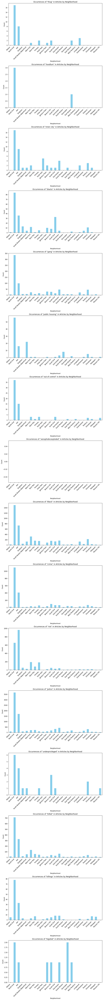

In [46]:
# Plotting the results
fig, axes = plt.subplots(nrows=len(keywords), ncols=1, figsize=(10, 6 * len(keywords)))

for i, keyword in enumerate(keywords):
    ax = axes[i]
    df_counts[keyword].plot(kind='bar', ax=ax, color='skyblue')
    ax.set_title(f'Occurrences of "{keyword}" in Articles by Neighborhood')
    ax.set_xlabel('Neighborhood')
    ax.set_ylabel('Count')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()
plt.show()

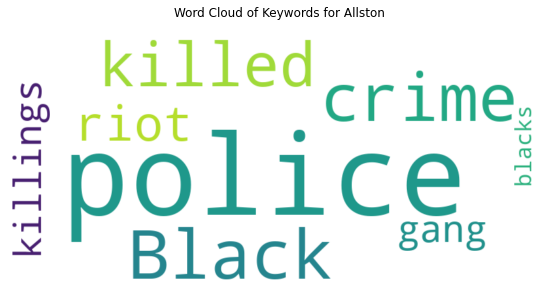

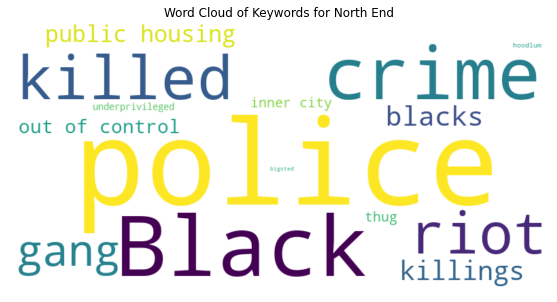

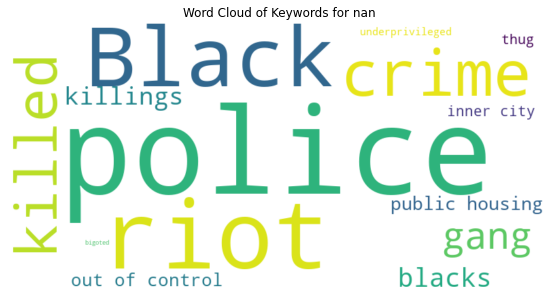

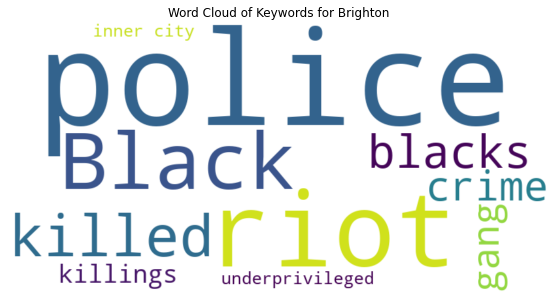

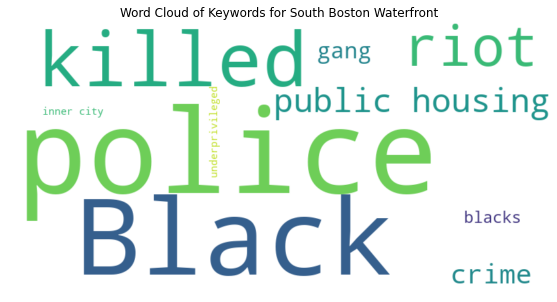

...

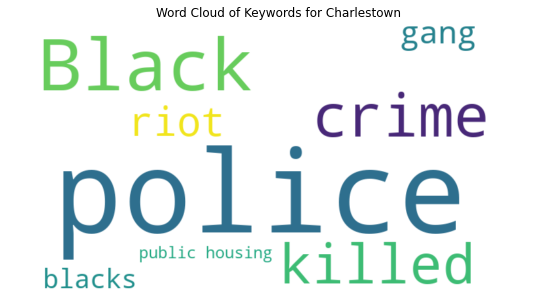

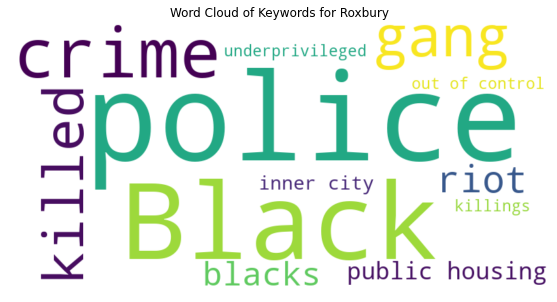

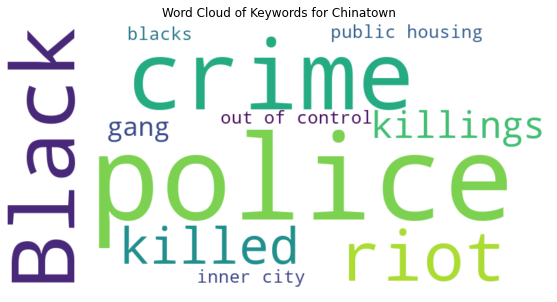

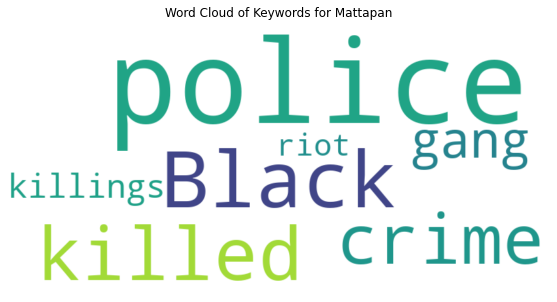

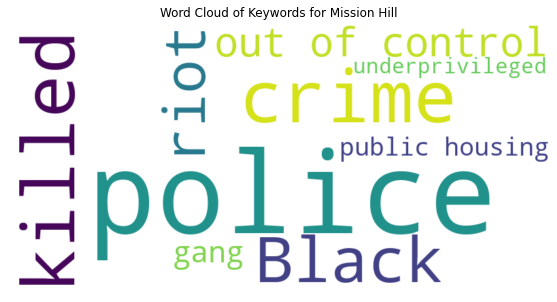

In [47]:
# Generating word cloud for each neighborhood based on the keywords list 
for neighborhood, keyword_count in neighborhood_counts.items():
    all_keywords = {keyword: count for keyword, count in keyword_count.items() if count > 0}
    if all_keywords:
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(all_keywords)
        
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.title(f'Word Cloud of Keywords for {neighborhood}')
        plt.axis('off')
        plt.show()
    else:
        print(f'No keywords found for {neighborhood}')

In [5]:
# Loading dataset that includes the 'body_cleaned' column 
df2 = pd.read_csv('/Users/rachelgupta/Desktop/NAACP - PIT NE/pitne-bias-in-media/summer24/notebooks/Rachel/final_combined3.csv')

In [6]:
# Displaying new dataframe
df2.head()

,hl1_x,body,position_section,position_subsection,author,year,body_cleaned,longitude,latitude,Tracts,...,T_Hispanic or Latino,Article_Count,T_majority_race,Neighborhood,White alone,Black or African American alone,Hispanic or Latino,"Asian, Native Hawaiian and Pacific Islander",Other Races or Multiple Races,majority_race
0,cerezyme alternative gets fda approval,washington the food and drug administration ha...,BUSINESS,unknown,Associated Press,2010.0,washington food drug administration approved n...,-71.118563,42.362780,803.0,...,576.0,35.0,T_White alone,Allston,12536.0,1326.0,3259.0,6271.0,1512.0,White alone
1,taking her own advice,while mckelle harbored big time ambitions her ...,G,Living Arts,unknown,2010.0,"mckelle harbored big- time ambitions , numerou...",-71.118116,42.360262,803.0,...,576.0,35.0,T_White alone,Allston,12536.0,1326.0,3259.0,6271.0,1512.0,White alone
2,terriers are triple threats vs. albany,as result shooting percentages tend to suffer ...,SPORTS,unknown,unknown,2010.0,"result , shooting percentages tend suffer terr...",-71.117705,42.352197,803.0,...,576.0,35.0,T_White alone,Allston,12536.0,1326.0,3259.0,6271.0,1512.0,White alone
3,10 are hurt as van overturns on mass. pike,marie eveillard 53 of brockton was taken by me...,NEWS,Metro,unknown,2010.0,"marie eveillard , 53 , brockton , taken medfli...",-71.119302,42.356444,803.0,...,576.0,35.0,T_White alone,Allston,12536.0,1326.0,3259.0,6271.0,1512.0,White alone
4,sanofi presses genzymeover takeover bid,in letter released yesterday sanofi aventis re...,BUSINESS,unknown,unknown,2010.0,"letter released yesterday , sanofi aventis rei...",-71.118563,42.362780,803.0,...,576.0,35.0,T_White alone,Allston,12536.0,1326.0,3259.0,6271.0,1512.0,White alone


In [7]:
# Ensuring the 'body_cleaned' column is a string
df2['body_cleaned'] = df2['body_cleaned'].astype(str)

In [8]:
# Loading spaCy model
nlp = spacy.load('en_core_web_sm')

In [60]:
# Preprocessing text in article body
def preprocess_text(text):
    doc = nlp(text)
    tokens = [token.lemma_.lower() for token in doc if not token.is_stop and not token.is_punct and not token.is_space]
    return tokens

# Applying function to body
df2['tokens'] = df2['body_cleaned'].apply(preprocess_text)


In [61]:
# Geting most frequent words for each neighborhood
def get_most_frequent_words(tokens_list, num_words=10):
    all_tokens = [token for tokens in tokens_list for token in tokens]
    return Counter(all_tokens).most_common(num_words)


In [63]:
neighborhoods = df2['Neighborhood'].unique()
frequent_words = {neighborhood: get_most_frequent_words(df2[df2['Neighborhood'] == neighborhood]['tokens']) for neighborhood in neighborhoods}

In [76]:
# Preparing data for the DataFrame
data = {'Neighborhood': [], 'Word': [], 'Frequency': []}

In [77]:
for neighborhood, words in frequent_words.items():
    for word, freq in words:
        data['Neighborhood'].append(neighborhood)
        data['Word'].append(word)
        data['Frequency'].append(freq)

In [78]:
# Create DataFrame
df_frequent_words = pd.DataFrame(data)

In [80]:
df_frequent_words

,Neighborhood,Word,Frequency
0,Allston,say,1105
1,Allston,year,417
2,Allston,boston,410
3,Allston,$,377
4,Allston,state,294
5,Allston,play,285
6,Allston,new,279
7,Allston,2,265
8,Allston,1,240
9,Allston,com,232


In [81]:
# Define the preprocessing function with additional stop words and focus on specific POS tags
def preprocess_text(text):
    doc = nlp(text)
    # Include additional stop words if needed
    additional_stop_words = set(["say", "said", "people", "one", "would", "could", "also", "like", "get", "go", "see", "make", "time", "well", "even", "year", "way", "use", "many", "much"])
    tokens = [
        token.lemma_.lower() for token in doc 
        if not token.is_stop and not token.is_punct and not token.is_space and token.lemma_.lower() not in additional_stop_words
        and token.pos_ in ["NOUN", "VERB", "ADJ", "ADV"]
    ]
    return tokens

# Apply the preprocessing function to the 'body_cleaned' column
df2['tokens'] = df2['body_cleaned'].apply(preprocess_text)

In [82]:
# Function to get the most frequent meaningful words
def get_most_frequent_words(tokens_list, num_words=10):
    all_tokens = [token for tokens in tokens_list for token in tokens]
    return Counter(all_tokens).most_common(num_words)

# Get the most frequent meaningful words for each neighborhood and create a keyword column
def create_keyword_column(df):
    neighborhoods = df['Neighborhood'].unique()
    keywords = {}
    for neighborhood in neighborhoods:
        neighborhood_tokens = df[df['Neighborhood'] == neighborhood]['tokens']
        frequent_words = get_most_frequent_words(neighborhood_tokens, num_words=10)
        keywords[neighborhood] = ' '.join([word for word, _ in frequent_words])
    df['Keywords'] = df['Neighborhood'].map(keywords)
    return df

# Apply the function to create the keyword column
df2 = create_keyword_column(df2)

# Display the DataFrame with the new keyword column
print(df2[['Neighborhood', 'Keywords']].head())

  Neighborhood                                           Keywords
0      Allston  play state company game work com point come re...
1      Allston  play state company game work com point come re...
2      Allston  play state company game work com point come re...
3      Allston  play state company game work com point come re...
4      Allston  play state company game work com point come re...


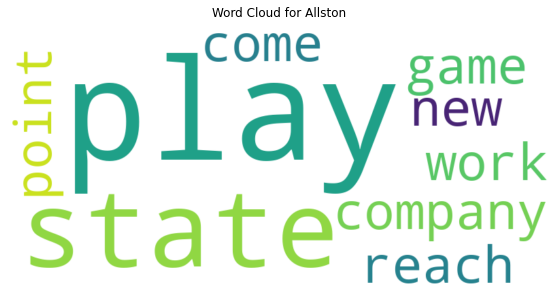

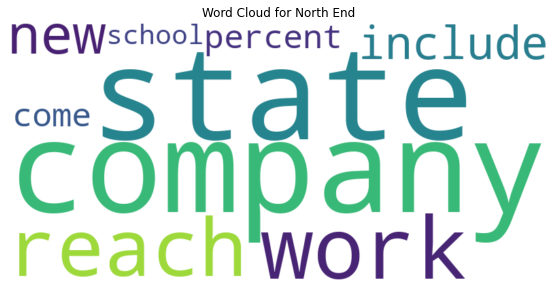

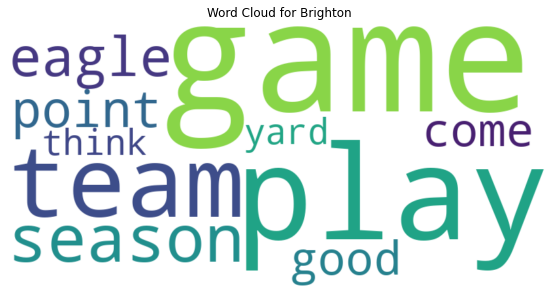

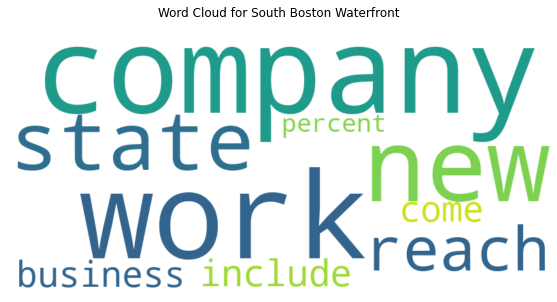

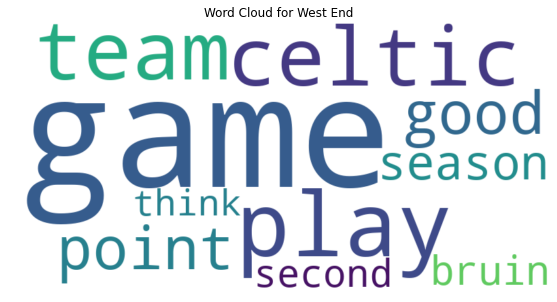

...

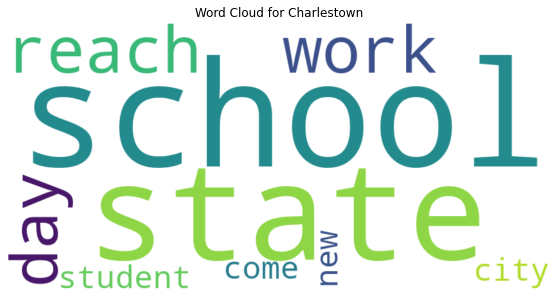

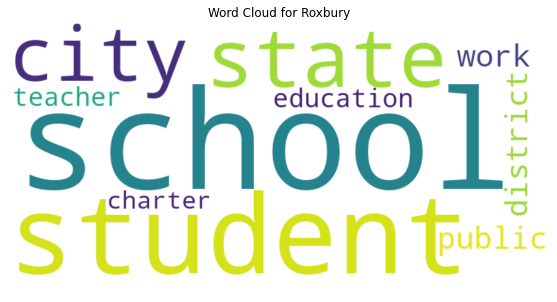

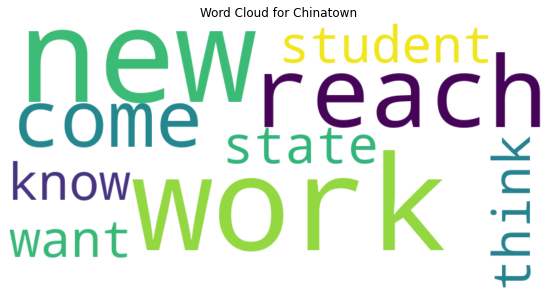

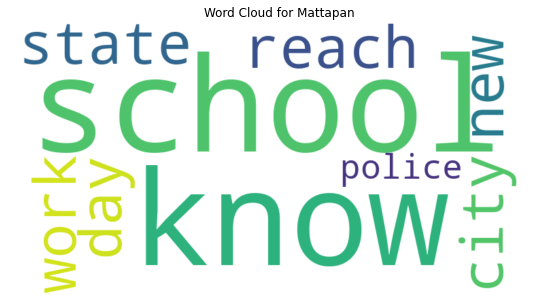

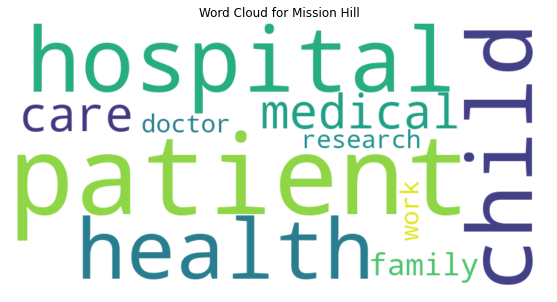

In [85]:
# Function to generate and display word cloud
def generate_word_cloud(keywords, neighborhood):
    if keywords:  # Only generate word cloud if there are keywords
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(keywords)
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f"Word Cloud for {neighborhood}")
        plt.show()

# Generate word cloud for each neighborhood
for neighborhood in df2['Neighborhood'].unique():
    keywords = df2[df2['Neighborhood'] == neighborhood]['Keywords'].values
    if len(keywords) > 0 and keywords[0]:  # Check if there are any keywords
        generate_word_cloud(keywords[0], neighborhood)

In [9]:
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

# Vectorize the text data using TF-IDF
vectorizer = TfidfVectorizer(stop_words='english')
X_train_tfidf = vectorizer.fit_transform(df2['body_cleaned'])

# Fit the KMeans model
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X_train_tfidf)

# Assign clusters to the articles
df2['cluster'] = kmeans.predict(vectorizer.transform(df2['body_cleaned']))



In [10]:
# Display the DataFrame to check the results
df3 = df2[['body_cleaned', 'cluster']]
df3.head()

,body_cleaned,cluster
0,washington food drug administration approved n...,0
1,"mckelle harbored big- time ambitions , numerou...",0
2,"result , shooting percentages tend suffer terr...",1
3,"marie eveillard , 53 , brockton , taken medfli...",0
4,"letter released yesterday , sanofi aventis rei...",4


In [11]:
import numpy as np

# Get the terms (words) from the vectorizer
terms = vectorizer.get_feature_names_out()

# Get the centroids (top terms) of each cluster
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]

# Print the top terms per cluster
for i in range(kmeans.n_clusters):
    print(f"Cluster {i}:")
    for ind in order_centroids[i, :20]:  
        print(f" {terms[ind]}")
    print()

Cluster 0:
 said
 boston
 people
 like
 new
 says
 com
 year
 time
 globe
 years
 family
 music
 body
 www
 day
 massachusetts
 life
 school
 work

Cluster 1:
 game
 celtics
 said
 season
 team
 points
 games
 play
 sox
 bruins
 coach
 win
 players
 going
 second
 good
 year
 got
 league
 scored

Cluster 2:
 baker
 said
 campaign
 state
 republican
 governor
 party
 democratic
 senate
 voters
 warren
 brown
 political
 election
 candidates
 patrick
 massachusetts
 democrats
 coakley
 candidate

Cluster 3:
 boston
 penalty
 11
 10
 bb
 2b
 12
 17
 13
 14
 totals
 18
 period
 bogaerts
 19
 3b
 shots
 ip
 16
 1b

Cluster 4:
 said
 state
 massachusetts
 percent
 health
 school
 company
 year
 students
 new
 boston
 people
 million
 city
 public
 care
 000
 police
 schools
 companies



In [12]:
# Display sample documents from each cluster
for cluster in range(kmeans.n_clusters):
    print(f"Cluster {cluster}:")
    sample_docs = df2[df2['cluster'] == cluster]['body_cleaned'].sample(3, random_state=42).values  # Adjust the number of samples as needed
    for doc in sample_docs:
        print(f" - {doc}")
    print()


Cluster 0:
 - peck j. todd harris , also serves film ' producer , hoping brings increased exposure lacrosse , already one fastest growing sports country . harris said $ 8 million film funded lacrosse aficionados supporters . scheduled released next year . film , crooked arrows , focuses native american lacrosse team competes better- trained prep schools . independent film stars brandon routh ( ` superman ' ) gil birmingham ( ` twilight ' ) , tv film actors chelsea ricketts crystal allen . dozens massachusetts high school college lacrosse players serve extras film , hand saturday st. john ' prep danvers , film ' climactic scenes shot championship game featuring crooked arrows . film ' producers contacted area high school youth coaches leagues recruit families lacrosse players fill stands extras . peck said extras take part aug. 13 filming register crookedarrows . com website . filming begins 7 a. m. lunch provided . also said shirts , lacrosse sticks , memorabilia movie given away filmi

In [13]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Perform t-SNE dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_train_tfidf.toarray())

# Plot the t-SNE results
plt.figure(figsize=(10, 6))
for cluster in range(kmeans.n_clusters):
    plt.scatter(X_tsne[df['cluster'] == cluster, 0], X_tsne[df['cluster'] == cluster, 1], label=f'Cluster {cluster}')
plt.legend()
plt.title("t-SNE Visualization of Document Clusters")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.show()

: 

In [92]:
# Generate TF-IDF matrix
tfidf_matrix = vectorizer.fit_transform(df2['body_cleaned'])

# Convert to DataFrame for better visualization
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=vectorizer.get_feature_names_out())

tfidf_df.head()

,00,000,0000,0000004,0000010,00000143,0000022,0000023,0000041,0000050,0000054,0000056,0000062,00001196,0000132,00002212,00002243,0001,00010101,00010152,0002,00020142,00021191,0005,0006,0007,0009,000officers,000people,000s,000th,000that,000workers,001,0010,0011,0018,001st,002,0020,0021,0022,0025,003,0030,0031,0035,0039,004,0040,0042,0047,005,0050,0055,0058,006,0060,0065,0069,007,0072,0075,007s,008,0086,009,0096,0097,00atchsn,00boston,00change,00low,00melancon1,00o,00oliver,00padilla023310144,00rogers1,00s,00smith100012173,00x,01,010,0100,0102,0103,011,0110002223,0110010163,01110034,01111103,0117,0118,012,01202,0122,0123,0125,013,0130,0134,0137,014,0149,015,0150,0157,016,01618122019,0167,0169,017,01701,0171,01720,01749,01773,0179,018,01867,019,019317264310,019518274520,01970,01x,02,020,0200,0202,02043,02056410,020th,021,02108,02109,02111,02114,02119,0212,02126,0213,02130,02139,02145,02155,02176,02184,02186,02196,022,02201,02205,02218,0222,0229,023,0234,02346,0236,024,02468357,024th,025,0252,026,0260,027,0270,0271,0272,0276,0278,028,0280,0282,0286,029,0295,0299,02x,03,030,0300,0305,030th,031,0310,03110,03175,032,0324,0328,032swampscott,033,0332,0333,034,0343,0345,035,0354,035vistaprint,036,037,0379,038,03874,038peabody,039,0396,0397,03melancon1,03nathan,03x,04,040,0400,041,0411,0413,0419,042,043,044,0442,0446,045,0456,046,0466,047,0479,048,0480,0484,0488,0489,049,0499,04x,05,050,0500,0501,0502,051,0515,0518,052,0528,053,0535,054,0543,0545,055,0550,0554,056,0565,05672,057,058,0589,058beverly,059,0597,05melancon,05norberto110001213,06,060,0600,061,062,0624american,063,0631,0633,064,065,0650,0655,066,0666,0669,067,0676,068,0683,069,0690,0696,06allen1,07,070,0701,0703,071,072,072back,073,0734,074,0744,0745,075,0751,0759,076,0763,0765,077,0770,078,0786,0787,0788,079,0790,0796,0797,07x,07xa,08,080,0800,0804,081,0810,0816,0817,082,0820,083,084,085,085wakefield,086,0860,0867,087,0870,088,0888,0889,089,0895,08robertson,09,090,0900,0902,0904,0909,091,0914,0916,0919,091winthrop,092,093,094,095,0956,096,0964,097,0977,098,0989,099,0991,0998,0999,0dover0,0f,0framingham10,0ld,0los,0n,0rpheum,0weston3,0xx,0¾,10,100,1000,100001162,1000082,1000182,10002257,10002373,1000508,1000d,1000s,1001,10010153,10011202,10011270,10013273,10045,1006,100at,100brooklyn,100denver,100golden,100k,100m,100on,100phoenix,100s,100th,100ths,101,1010,10106,1017051823,1017542644,1018,10190033,101at,101st,101washington,102,1020,102327,1027,102at,102boston,102d,102detroit,102indiana,102memphis,102new,102sacramento,103,1030,1032k,1033,1035,1038,103at,103d,103miami,103orlando,103rd,103utah,104,1040,1040s,1044,1045,1046,104at,104detroit,104utah,104½,104⅓,105,1050,1056,10575510875,105at,105new,105no,105sacra,105th,106,1060,1063112121015,1066,1068,106indiana,106memphis,106th,107,1070,1077,107at,107detroit,107th,107⅓,108,1080,1080p,108at,108denver,108detroit,108indiana,108new,108orlando,108th,109,1090,1091,1095,1096,1098,1099,109at,109detroit,109new,109s,10and,10at,10badenhop1,10cape,10chi,10g,10greater,10in,10k,10ks,10m,10medway16,10miami,10noanthony,10paint,10rising,10s,10salem10southern,10san,10seattle,10th,10ths,10toronto,10who,10x,10x10,10½,10¾,10⅓,10⅔,11,110,1100,11000091,110001161,1101,1103,110at,110brooklyn,110th,110wash,110x,111,1110,11101172,1111,1117012322,1119214173121,111at,111minnesota,111punto,112,1120,1121,1122,1122211251,1128,1129,112at,112la,112phoenix,112th,112washington,113,1139,113at,113boston,113th,113washington,114,114at,114boston,114golden,114houston,114minnesota,114sacramento,114source,114th,115,1153,1154,1155,115at,115chicago,115dallas,115mg,115phoenix,115th,115⅔,116,1160,1164,1166,1167,116at,116milwaukee,116okla,116th,117,1176,117at,117chicago,117okla,117th,118,1180,1181,118190,1185,118boston,118th,119,11914atlantic,11946212717,1195,119524611,1195761326,1196,1199,1199seiu,119at,119indiana,119la,119minnesota,119th,11at,11b,11chi,11g,11nepga,11oakland,11philadelphia,11th,11x,11¼,11½,11¾,11⅓,11⅔,12,120,1200,12003,12004,12012,1204,1205,1208,1209,120b,120denv

In [93]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a co-occurrence matrix
co_occurrence_matrix = (tfidf_matrix.T * tfidf_matrix)
co_occurrence_matrix.setdiag(0)

# Create a graph from the co-occurrence matrix
G = nx.from_scipy_sparse_matrix(co_occurrence_matrix)

# Plot the graph
plt.figure(figsize=(10, 10))
pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, node_size=50)
nx.draw_networkx_edges(G, pos, alpha=0.3)
plt.title("Co-occurrence Network")
plt.show()

: 